<img src="http://hilpisch.com/tpq_logo.png" alt="The Python Quants" width="35%" align="right" border="0"><br>

# Python for Finance (2nd ed.)

**Mastering Data-Driven Finance**

&copy; Dr. Yves J. Hilpisch | The Python Quants GmbH

<img src="http://hilpisch.com/images/py4fi_2nd_shadow.png" width="300px" align="left">

# Statistics (a)

- 正态性检验

许多重要金融模型，如均值-方差投资组合理论和资本性资产定价模型（CAPM），都依赖于证券收益呈正态分布这一假设。因此，本章介绍一些方法，测试给定时间序列的正态性。
- 投资组合优化

可以将现代投资组合理论（MPT）看作金融统计学的最大成功之一。从20世纪50年代初开始，由于先驱者HarryMarkowitz的努力，这一理论开始用严格的数学和统计学方法，代替人们投资金融市场时对判断和经验的依赖。在这个意义上，它可能是金融学中第一种真正的计量方法。
- 贝叶斯统计

从概念层面上，贝叶斯统计在统计学中引入了主体信念度和信念度更新；例如，对于线性回归，可能采取回归参数统计分布的形式代替单点估算（如回归线截距和斜率）。如今，贝叶斯方法在金融学中相当流行和重要，这也是我们在本章中阐述一些（高级）应用的原因。

- 机器学习

机器学习（或者统计学习）基于高级统计学方法，被视为人工智能（AI）学科的分支。和统计学本身类似，机器学习提供一组丰富的方法和模型，以便从数据集中学习，并根据所学建立预测。不同的学习算法有很大的区别，例如有监督学习或无监督学习。算法解决的问题类型也不同，如估算或者分类。本章介绍的例子属于有监督学习分类。

## Normality Tests

- 投资组合理论

当股票收益呈正态分布时，最优化投资组合可以在这样的环境中选择：只有平均收益、收益的方差（或者波动率）以及不同股票之间的协方差与投资决策（即最优化投资组合构成）相关。

- 资本性资产定价模型

同样，当股票收益呈正态分布时，单独证券的价格可以很好地用和某种大规模市场指数的关系表示；这种关系通常用单一股票与市场指数的联动指标（β）表示

- 有效市场假设

有效市场指的是价格反映所有可用信息的市场，其中的“所有”可以是狭义的，也可以是广义的（例如“所有公开信息”或者同时包括“只为个人所有”的信息）。如果这个假设成立，股票价格波动将是随机的，而收益呈正态分布。

- 期权定价理论

布朗运动是随机股票（和其他证券）价格变动的标准、基准模型。著名的Black- Scholes-Merton期权定价公式使用几何布朗运动作为股票在一段时间内随机波动的模型，这种波动造成收益呈正态分布。

### Benchmark Case

In [195]:
import math
import numpy as np
import scipy.stats as scs
import statsmodels.api as sm
from pylab import mpl, plt

In [196]:
plt.style.use('seaborn')
mpl.rcParams['font.family'] = 'serif'
%matplotlib inline

In [197]:
# 函数gen_paths()为几何布朗运动生成蒙特卡洛路径
def gen_paths(S0, r, sigma, T, M, I):
    ''' Generate Monte Carlo paths for geometric Brownian motion.
    
    Parameters
    ==========
    S0: float
        initial stock/index value
    r: float
        constant short rate
    sigma: float
        constant volatility
    T: float
        final time horizon
    M: int
        number of time steps/intervals
    I: int
        number of paths to be simulated
        
    Returns
    =======
    paths: ndarray, shape (M + 1, I)
        simulated paths given the parameters
    '''
    dt = T / M
    paths = np.zeros((M + 1, I))
    paths[0] = S0
    for t in range(1, M + 1):
        rand = np.random.standard_normal(I)
        rand = (rand - rand.mean()) / rand.std()  # 匹配一阶矩和二阶矩，使生成的随机数符合标准正态分布。就算生成的随机数也不是一定是正态的随机数，所以在这里进行匹配。
        paths[t] = paths[t - 1] * np.exp((r - 0.5 * sigma ** 2) * dt + sigma * math.sqrt(dt) * rand)  # 向量化的几何布朗运动欧拉离散
    return paths

In [198]:
S0 = 100.  
r = 0.05  
sigma = 0.2  
T = 1.0   
M = 50  
I = 250000  
np.random.seed(1000)

In [199]:
paths = gen_paths(S0, r, sigma, T, M, I)

In [200]:
S0 * math.exp(r * T)  

105.12710963760242

In [201]:
paths[-1].mean()  

105.12645392478755

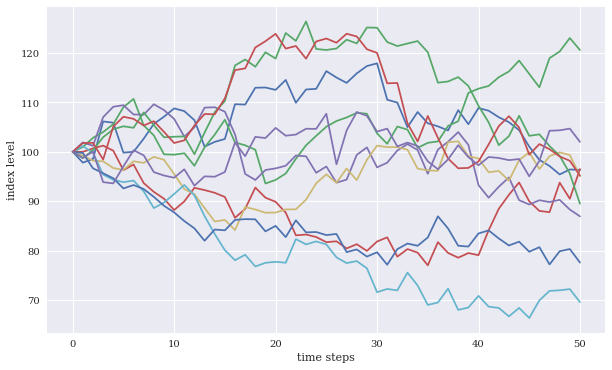

In [202]:
plt.figure(figsize=(10, 6))
plt.plot(paths[:, :10])
plt.xlabel('time steps')
plt.ylabel('index level');
# plt.savefig('../../images/ch13/stat_01.png');

In [203]:
paths[:, 0].round(4)

array([100.    ,  97.821 ,  98.5573, 106.1546, 105.899 ,  99.8363,
       100.0145, 102.6589, 105.6643, 107.1107, 108.7943, 108.2449,
       106.4105, 101.0575, 102.0197, 102.6052, 109.6419, 109.5725,
       112.9766, 113.0225, 112.5476, 114.5585, 109.942 , 112.6271,
       112.7502, 116.3453, 115.0443, 113.9586, 115.8831, 117.3705,
       117.9185, 110.5539, 109.9687, 104.9957, 108.0679, 105.7822,
       105.1585, 104.3304, 108.4387, 105.5963, 108.866 , 108.3284,
       107.0077, 106.0034, 104.3964, 101.0637,  98.3776,  97.135 ,
        95.4254,  96.4271,  96.3386])

In [204]:
# 类似shift的方法
log_returns = np.log(paths[1:] / paths[:-1]) 

In [205]:
log_returns[:, 0].round(4)

array([-0.022 ,  0.0075,  0.0743, -0.0024, -0.059 ,  0.0018,  0.0261,
        0.0289,  0.0136,  0.0156, -0.0051, -0.0171, -0.0516,  0.0095,
        0.0057,  0.0663, -0.0006,  0.0306,  0.0004, -0.0042,  0.0177,
       -0.0411,  0.0241,  0.0011,  0.0314, -0.0112, -0.0095,  0.0167,
        0.0128,  0.0047, -0.0645, -0.0053, -0.0463,  0.0288, -0.0214,
       -0.0059, -0.0079,  0.0386, -0.0266,  0.0305, -0.0049, -0.0123,
       -0.0094, -0.0153, -0.0324, -0.0269, -0.0127, -0.0178,  0.0104,
       -0.0009])

In [206]:
import warnings; warnings.simplefilter('ignore')

In [207]:
def print_statistics(array):
    ''' Prints selected statistics.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    sta = scs.describe(array)
    print('%14s %15s' % ('statistic', 'value'))
    print(30 * '-')
    print('%14s %15.5f' % ('size', sta[0]))
    print('%14s %15.5f' % ('min', sta[1][0]))
    print('%14s %15.5f' % ('max', sta[1][1]))
    print('%14s %15.5f' % ('mean', sta[2]))
    print('%14s %15.5f' % ('std', np.sqrt(sta[3])))
    print('%14s %15.5f' % ('skew', sta[4]))
    print('%14s %15.5f' % ('kurtosis', sta[5]))

In [208]:
print_statistics(log_returns.flatten())

statistic           value
------------------------------
          size  12500000.00000
           min        -0.15664
           max         0.15371
          mean         0.00060
           std         0.02828
          skew         0.00055
      kurtosis         0.00085


In [209]:
# 按照伊藤公式校正的年化对数收益率均值
# 因为ln(St/St-1) = np.exp((r - 0.5 * sigma ** 2) * dt + sigma * math.sqrt(dt) * rand)
# 所以期待值就是(r - 0.5 * sigma ** 2) * dt = 0.00060，标准差就是sigma * math.sqrt(dt) = 0.02828
# 所以要恢复r的时候要用下面的公式
log_returns.mean() * M + 0.5 * sigma ** 2  

0.05000000000000006

In [210]:
# 年化波动率，也就是对数收益的年化标准差
# 要恢复标准差，就要/math.sqrt(dt) = *math.sqrt(M)
log_returns.std() * math.sqrt(M)  

0.20000000000000015

(array([1.80444531e-05, 1.80444531e-05, 0.00000000e+00, 1.08266719e-04,
        1.62400078e-04, 1.44355625e-04, 3.42844609e-04, 1.04657828e-03,
        1.91271203e-03, 3.71715734e-03, 7.03733672e-03, 1.22160948e-02,
        2.22127218e-02, 3.90301521e-02, 6.44547866e-02, 1.05920940e-01,
        1.70700527e-01, 2.68086440e-01, 4.11774420e-01, 6.24572656e-01,
        9.00291900e-01, 1.28449440e+00, 1.79269837e+00, 2.43206748e+00,
        3.21981613e+00, 4.17135427e+00, 5.26457747e+00, 6.47718276e+00,
        7.78163432e+00, 9.10394989e+00, 1.04145366e+01, 1.16205015e+01,
        1.26391289e+01, 1.34710143e+01, 1.39469548e+01, 1.40602198e+01,
        1.38974047e+01, 1.33810807e+01, 1.26021739e+01, 1.15323363e+01,
        1.03238993e+01, 9.02260550e+00, 7.68316574e+00, 6.39603686e+00,
        5.17132373e+00, 4.09594650e+00, 3.16431139e+00, 2.38619848e+00,
        1.76241978e+00, 1.25690443e+00, 8.85369137e-01, 6.00266778e-01,
        4.04285972e-01, 2.62618971e-01, 1.65774391e-01, 1.013737

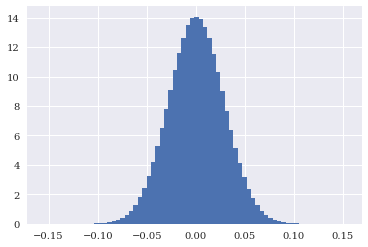

In [211]:
hist = plt.hist(np.log(paths[1:] / paths[:-1]).flatten(), bins = 70, density = True)
hist

In [212]:
np.sum(np.diff(hist[1]) * hist[0])

1.0000000000000002

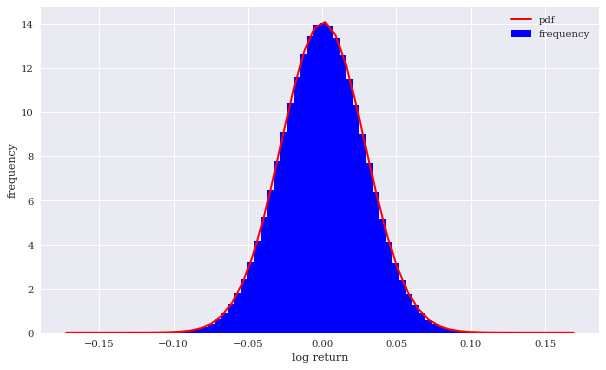

In [213]:
plt.figure(figsize=(10, 6))
# density = True就保证了蓝色面积总和为1
plt.hist(log_returns.flatten(), bins=70, density=True,
         label='frequency', color='b')
plt.xlabel('log return')
plt.ylabel('frequency')
# plt.axis()就是xmin, xmax, ymin, ymax，所以可以直接用这个取得范围
x = np.linspace(plt.axis()[0], plt.axis()[1])
# pdf: 概率密度分布曲线
# 实际期待平均值是r - 0.5*sigma**2，此处进行修改
plt.plot(x, scs.norm.pdf(x, loc=(r - 0.5 * sigma ** 2) / M, scale=sigma / np.sqrt(M)),
         'r', lw=2.0, label='pdf')  
plt.legend();
# plt.savefig('../../images/ch13/stat_02.png');

对比频率分布（直方图）与理论化PDF不是图形化“检验”正态性的唯一方法。所谓的分位数-分位数（quantile-quantile，QQ）图也很适合于这一任务。在这种图表中，我们对样本分位数值与理论分位数值进行对比。

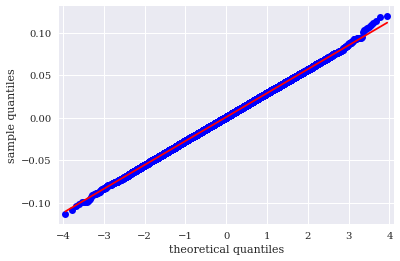

In [214]:
# ::500是选取所有的数，但是以500为步长
# theoretical quantiles里的1代表mean + 1 * sigma
# 实际的点就是N-1(x)，就是x的正态分布上的对应点
sm.qqplot(log_returns.flatten()[::500], line='s')
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles');
# plt.savefig('../../images/ch13/stat_03.png');
# 绝大多数分位数值（点）位于一条直线上

In [215]:
def normality_tests(arr):
    ''' Tests for normality distribution of given data set.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    # 测试样本数据的偏斜是否“正态”（也就是值足够接近0）
    print('Skew of data set  %14.3f' % scs.skew(arr))
    print('Skew test p-value %14.3f' % scs.skewtest(arr)[1])
    # 与偏斜度测试类似，测试样本数据的峰度是否“正态”（同样是值足够接近0）。
    print('Kurt of data set  %14.3f' % scs.kurtosis(arr))
    print('Kurt test p-value %14.3f' % scs.kurtosistest(arr)[1])
    # 组合其他两种测试方法，检验正态性。
    print('Norm test p-value %14.3f' % scs.normaltest(arr)[1])

In [216]:
normality_tests(log_returns.flatten()) 
# 测试值表明，几何布朗运动的对数收益率确实呈正态分布。也就是说，它们的 p 值为0.05或者更高 

Skew of data set           0.001
Skew test p-value          0.430
Kurt of data set           0.001
Kurt test p-value          0.541
Norm test p-value          0.607


Text(0.5, 1.0, 'log data')

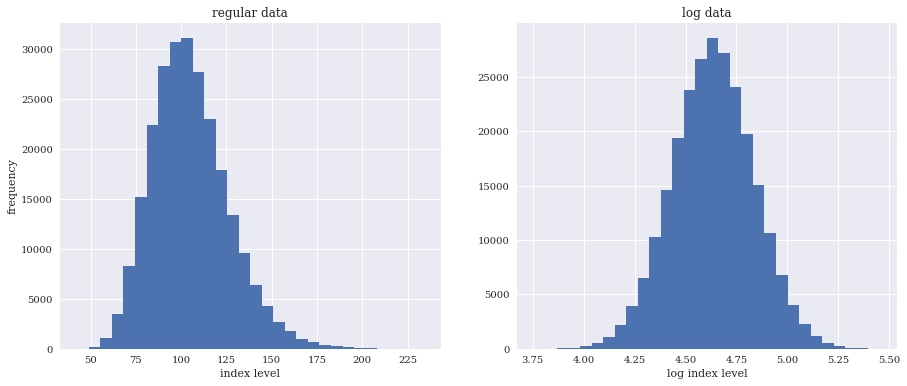

In [217]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
# 右偏倾向，对数正态分布
ax1.hist(paths[-1], bins=30)
ax1.set_xlabel('index level')
ax1.set_ylabel('frequency')
ax1.set_title('regular data')
# 应用对数函数来转换数据以得到正态分布数据（也可能得不到）
ax2.hist(np.log(paths[-1]), bins=30)
ax2.set_xlabel('log index level')
ax2.set_title('log data')
# plt.savefig('../../images/ch13/stat_04.png');

In [218]:
print_statistics(paths[-1])

statistic           value
------------------------------
          size    250000.00000
           min        42.74870
           max       233.58435
          mean       105.12645
           std        21.23174
          skew         0.61116
      kurtosis         0.65182


In [219]:
# 理论期末股价
S0 * np.exp(0.05 * T)

105.12710963760242

In [220]:
print_statistics(np.log(paths[-1]))

statistic           value
------------------------------
          size    250000.00000
           min         3.75534
           max         5.45354
          mean         4.63517
           std         0.19998
          skew        -0.00092
      kurtosis        -0.00327


In [221]:
# 理论的log(ST)值，正态分布项平均为0
np.log(S0) + (r - 0.5 * sigma ** 2)

4.635170185988092

In [222]:
normality_tests(np.log(paths[-1]))

Skew of data set          -0.001
Skew test p-value          0.851
Kurt of data set          -0.003
Kurt test p-value          0.744
Norm test p-value          0.931


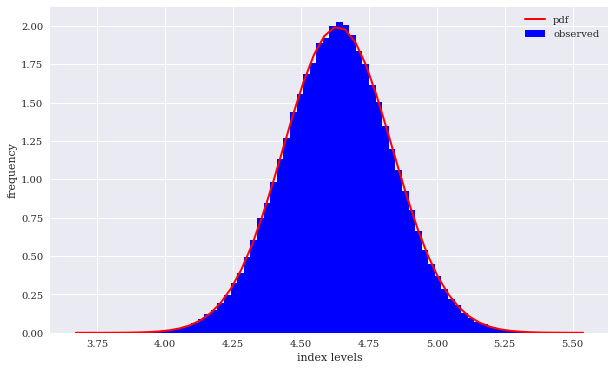

In [223]:
plt.figure(figsize=(10, 6))
log_data = np.log(paths[-1])
plt.hist(log_data, bins=70, density=True,
         label='observed', color='b')
plt.xlabel('index levels')
plt.ylabel('frequency')
x = np.linspace(plt.axis()[0], plt.axis()[1])
plt.plot(x, scs.norm.pdf(x, log_data.mean(), log_data.std()),
         'r', lw=2.0, label='pdf')
plt.legend();
# plt.savefig('../../images/ch13/stat_05.png');

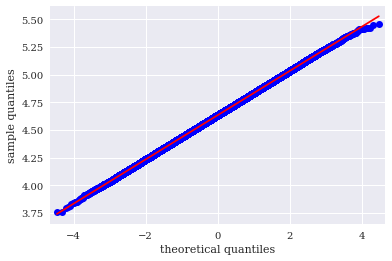

In [224]:
# 红线就是mean + sigma * x
sm.qqplot(log_data, line='s')
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles');
# plt.savefig('../../images/ch13/stat_06.png');

证券收益的正态性假设是许多重要金融理论的核心。Python提供了高效的统计和图形手段，以测试时间序列数据是否为正态分布。

### Real World Data

本节将分析 4 个历史金融时间序列，其中两个是技术型公司的股票，另两个是交易型开放式基金（ETF），具体如下。

APPL.0：苹果公司股价。

MSFT.0：微软公司股价。

SPY：标准普尔500 ETF。

GLD：标准普尔黄金ETF。

In [225]:
import pandas as pd

In [226]:
raw = pd.read_csv('../../source/tr_eikon_eod_data.csv',
                 index_col=0, parse_dates=True).dropna()

In [227]:
symbols = ['SPY', 'GLD', 'AAPL.O', 'MSFT.O']

In [228]:
data = raw[symbols]
data = data.dropna()

In [229]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2138 entries, 2010-01-04 to 2018-06-29
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   SPY     2138 non-null   float64
 1   GLD     2138 non-null   float64
 2   AAPL.O  2138 non-null   float64
 3   MSFT.O  2138 non-null   float64
dtypes: float64(4)
memory usage: 83.5 KB


In [230]:
data.head()

,SPY,GLD,AAPL.O,MSFT.O
Date,,,,
2010-01-04,113.33,109.80,30.572827,30.950
2010-01-05,113.63,109.70,30.625684,30.960
2010-01-06,113.71,111.51,30.138541,30.770
2010-01-07,114.19,110.82,30.082827,30.452
2010-01-08,114.57,111.37,30.282827,30.660


In [231]:
data.iloc[0]

SPY       113.330000
GLD       109.800000
AAPL.O     30.572827
MSFT.O     30.950000
Name: 2010-01-04 00:00:00, dtype: float64

<AxesSubplot:xlabel='Date'>

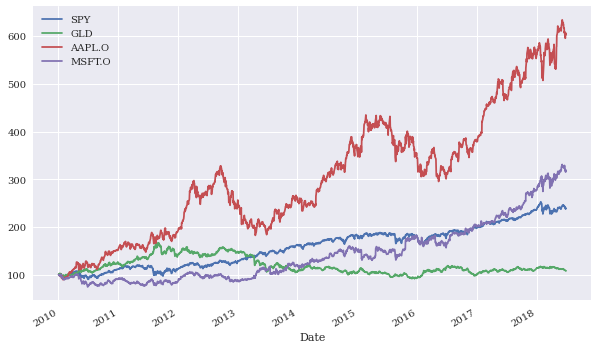

In [232]:
# 使股价统一从100开始
# dataframe / dataframe
# 通过data.iloc就能抓出某一行，或者一堆行
(data / data.iloc[0] * 100).plot(figsize=(10, 6))
# plt.savefig('../../images/ch13/stat_07.png');

In [233]:
# 算回报率
log_returns = np.log(data / data.shift(1))
log_returns.head()

,SPY,GLD,AAPL.O,MSFT.O
Date,,,,
2010-01-04,NaN,NaN,NaN,NaN
2010-01-05,0.002644,-0.000911,0.001727,0.000323
2010-01-06,0.000704,0.016365,-0.016034,-0.006156
2010-01-07,0.004212,-0.006207,-0.001850,-0.010389
2010-01-08,0.003322,0.004951,0.006626,0.006807


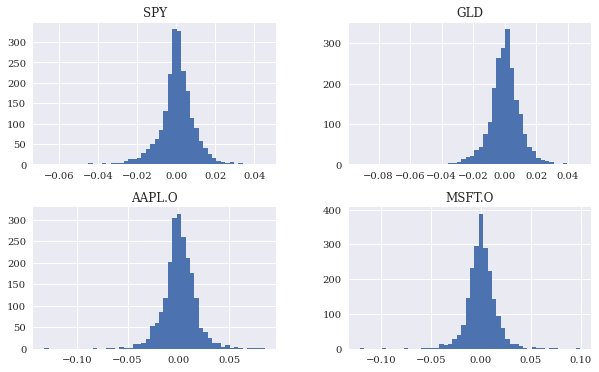

In [234]:
# 肥尾，峰度高
fig = log_returns.hist(bins=50, figsize=(10, 6));
# plt.savefig('../../images/ch13/stat_08.png');

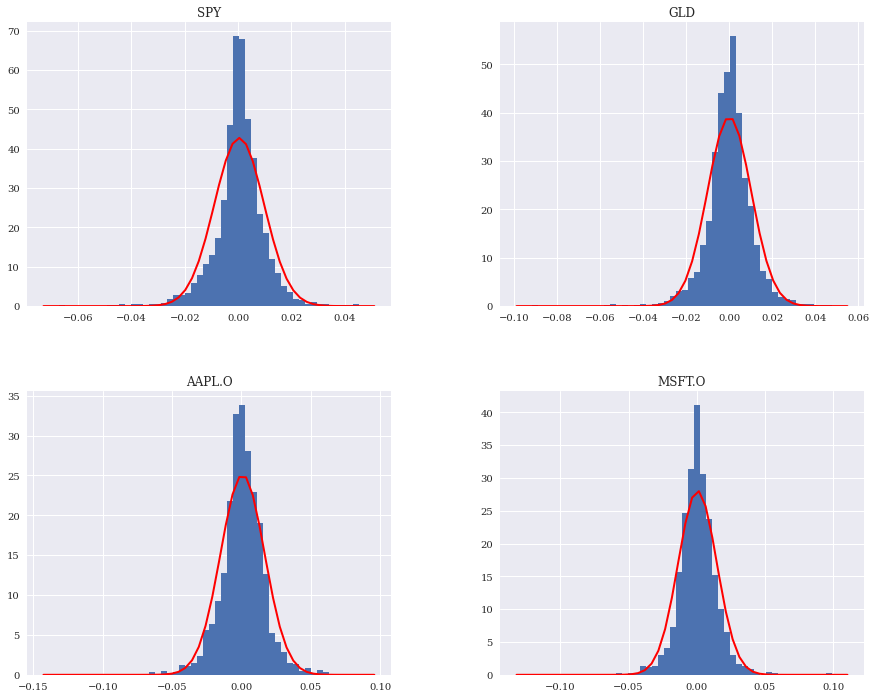

In [235]:
# 肥尾，峰度高
fig = log_returns.hist(bins=50, figsize=(15, 12), density = True);
x = np.linspace(fig[0][0].axis()[0], fig[0][0].axis()[1])
fig[0][0].plot(x, scs.norm.pdf(x, log_returns['SPY'].mean(), log_returns['SPY'].std()),
         'r', lw=2.0, label='pdf')
x = np.linspace(fig[0][1].axis()[0], fig[0][1].axis()[1])
fig[0][1].plot(x, scs.norm.pdf(x, log_returns['GLD'].mean(), log_returns['GLD'].std()),
         'r', lw=2.0, label='pdf')
x = np.linspace(fig[1][0].axis()[0], fig[1][0].axis()[1])
fig[1][0].plot(x, scs.norm.pdf(x, log_returns['AAPL.O'].mean(), log_returns['AAPL.O'].std()),
         'r', lw=2.0, label='pdf')
x = np.linspace(fig[1][1].axis()[0], fig[1][1].axis()[1])
fig[1][1].plot(x, scs.norm.pdf(x, log_returns['MSFT.O'].mean(), log_returns['MSFT.O'].std()),
         'r', lw=2.0, label='pdf')
# plt.savefig('../../images/ch13/stat_08.png');

In [236]:
for sym in symbols:
    print('\nResults for symbol {}'.format(sym))
    print(30 * '-')
    log_data = np.array(log_returns[sym].dropna())
    print_statistics(log_data)  


Results for symbol SPY
------------------------------
     statistic           value
------------------------------
          size      2137.00000
           min        -0.06734
           max         0.04545
          mean         0.00041
           std         0.00933
          skew        -0.52189
      kurtosis         4.52432

Results for symbol GLD
------------------------------
     statistic           value
------------------------------
          size      2137.00000
           min        -0.09191
           max         0.04795
          mean         0.00004
           std         0.01020
          skew        -0.59934
      kurtosis         5.68423

Results for symbol AAPL.O
------------------------------
     statistic           value
------------------------------
          size      2137.00000
           min        -0.13187
           max         0.08502
          mean         0.00084
           std         0.01591
          skew        -0.23510
      kurtosis         4.7

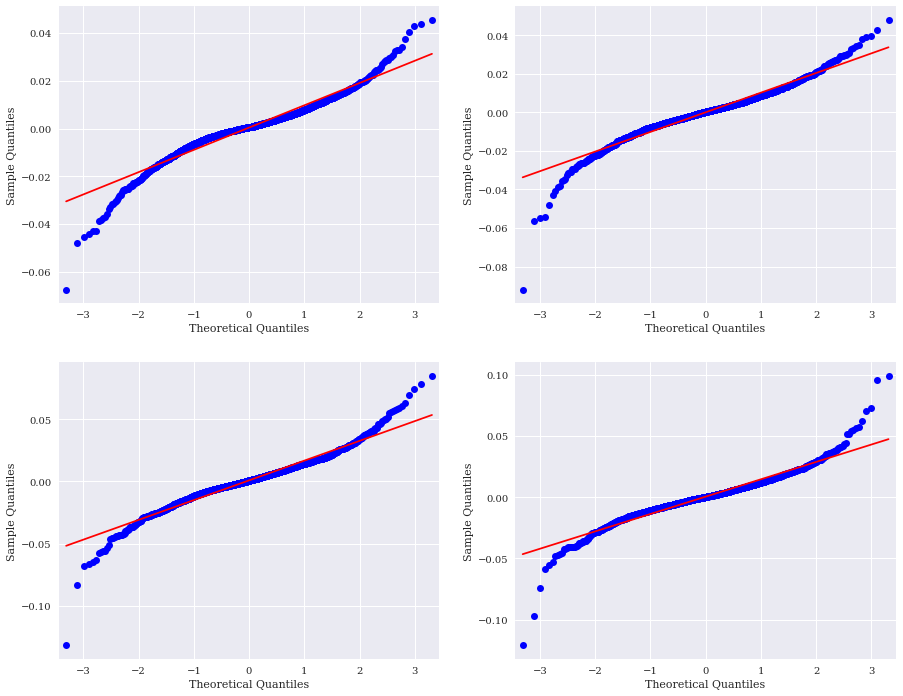

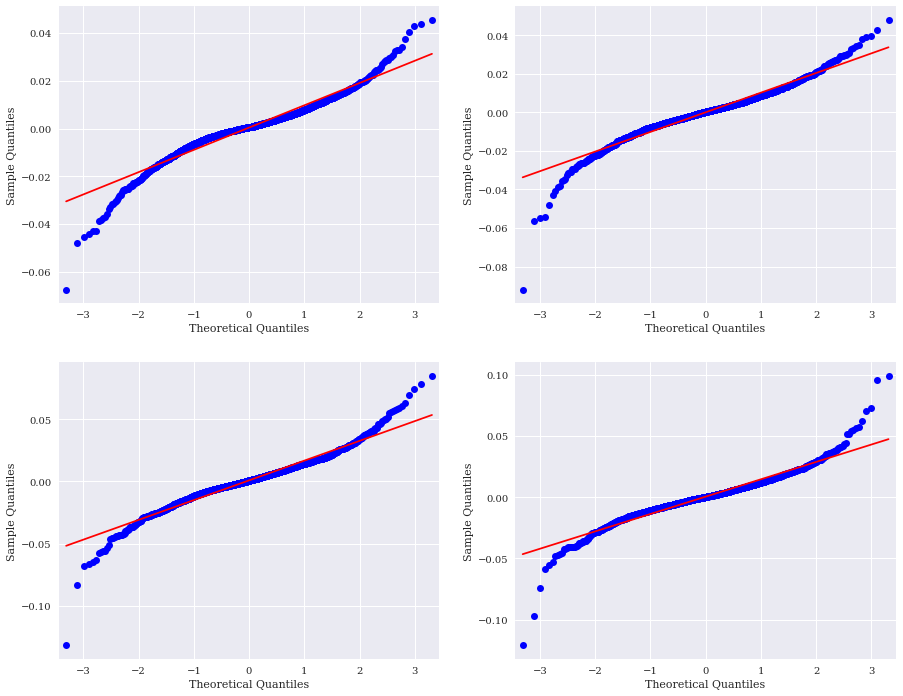

In [237]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize=(15, 12))
# 右偏倾向，对数正态分布
sm.qqplot(log_returns['SPY'].dropna(), line='s', ax = axes[0][0])
sm.qqplot(log_returns['GLD'].dropna(), line='s', ax = axes[0][1])
sm.qqplot(log_returns['AAPL.O'].dropna(), line='s', ax = axes[1][0])
sm.qqplot(log_returns['MSFT.O'].dropna(), line='s', ax = axes[1][1])

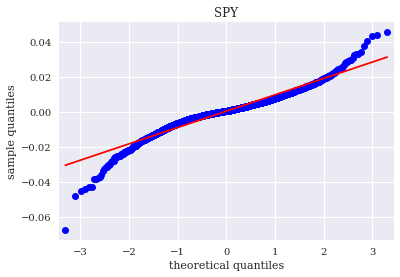

In [238]:
sm.qqplot(log_returns['SPY'].dropna(), line='s')
plt.title('SPY')
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles');
# plt.savefig('../../images/ch13/stat_09.png');
# 样本的分位数值不在一条直线上，表明“非正态性”。在左侧和右侧分别有许多值远低于和远高于直线。换言之，这一时间序列信息出现了“大尾巴”（Fat tails）大尾巴一词指的是（频率）分布中观察到的正负异常值远多于正态分布应有表现的情况。

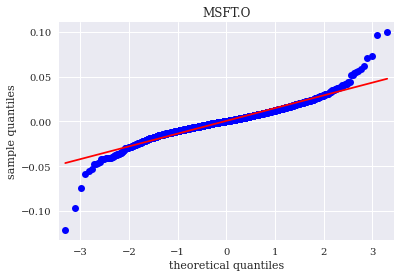

In [239]:
sm.qqplot(log_returns['MSFT.O'].dropna(), line='s')
plt.title('MSFT.O')
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles');
# plt.savefig('../../images/ch13/stat_10.png');

In [240]:
for sym in symbols:
    print('\nResults for symbol {}'.format(sym))
    print(32 * '-')
    log_data = np.array(log_returns[sym].dropna())
    normality_tests(log_data) 
    # 不同测试的p值都为0，强烈否决不同样板数据集呈正态分布的测试假设。 


Results for symbol SPY
--------------------------------
Skew of data set          -0.522
Skew test p-value          0.000
Kurt of data set           4.524
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol GLD
--------------------------------
Skew of data set          -0.599
Skew test p-value          0.000
Kurt of data set           5.684
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol AAPL.O
--------------------------------
Skew of data set          -0.235
Skew test p-value          0.000
Kurt of data set           4.790
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol MSFT.O
--------------------------------
Skew of data set          -0.091
Skew test p-value          0.085
Kurt of data set           7.291
Kurt test p-value          0.000
Norm test p-value          0.000


自始至终，不同测试的p值都为0，强烈否决不同样板数据集呈正态分布的测试假设。这说明，股票市场收益率的正态假设——例如几何布朗运动模型中的假设——通常无法证明是正确的，可能需要使用可以产生“大尾巴”的更丰富模型（例如，跳跃扩散模型或者具备随机波动率的模型）

## Portfolio Optimization

均值-方差投资组合理论（MPT）是金融理论的重要基础。

只观察均值和方差，我们必然假定没有必要用其他统计量描述期末财富的分布。除非投资者有特殊的效用函数（二次效用函数），否则有必要假设收益率呈正态分布，正态分布用均值和方差就可以完整地描述。

### The Data

下面的分析和示例使用了和前面相同的金融工具。MPT的基本思路是通过分散投资实现投资组合风险最小化，或者在指定风险水平下的组合收益最大化。通过合理地组合足够大量的资产并让资产多样化，可以实现预期的结果。

投资资产的协方差矩阵是整个投资组合选择过程的核心部分。pandas 有一个内建方法，可以生成协方差矩阵，该矩阵应用相同的比例调整因子

In [241]:
symbols = ['AAPL.O', 'MSFT.O', 'SPY', 'GLD']  

In [242]:
noa = len(symbols)  

In [243]:
data = raw[symbols]

In [244]:
rets = np.log(data / data.shift(1))

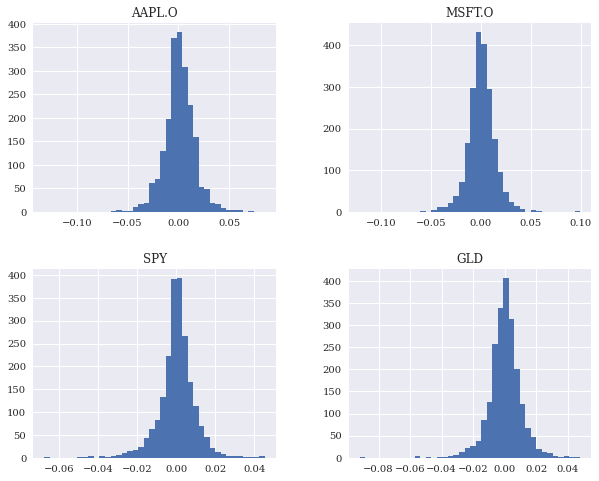

In [245]:
rets.hist(bins=40, figsize=(10, 8));
# plt.savefig('../../images/ch13/stat_11.png')

In [246]:
rets.mean() * 252  
# 年化平均收益率

AAPL.O    0.212359
MSFT.O    0.136648
SPY       0.102928
GLD       0.009141
dtype: float64

In [247]:
rets.cov() * 252  
# 年化协方差矩阵
# 假设每一天的回报率都是i.i.d

,AAPL.O,MSFT.O,SPY,GLD
AAPL.O,0.063773,0.023427,0.021039,0.001513
MSFT.O,0.023427,0.050917,0.022244,-0.000347
SPY,0.021039,0.022244,0.021939,0.000062
GLD,0.001513,-0.000347,0.000062,0.026209


### The Basic Theory

下面，我们假定投资者不允许在某种金融工具上建立空头头寸。只允许多头头寸意味着投资者的财富将在可用资产中分配，所有头寸均为多头（正）头寸，且头寸的总和为100%。例如，可以在每种工具中投入相同的资金量（每种25%）。下面的代码生成4个0和1之间的随机数，然后对这些数值进行规范化，使所有值的总和为1

In [248]:
weights = np.random.random(noa)  
weights /= np.sum(weights)  # 将其规范化为1或者100%

In [249]:
weights

array([0.07650728, 0.06021919, 0.63364218, 0.22963135])

In [250]:
weights.sum()

1.0

In [251]:
rets.mean()

AAPL.O    0.000843
MSFT.O    0.000542
SPY       0.000408
GLD       0.000036
dtype: float64

In [252]:
# E(wiri) = wiE(ri) = W.dot(R)
# 给定投资组合权重下的年化收益率
np.sum(rets.mean() * weights) * 252  

0.09179459482057793

在 MPT 中选择的第二个对象是预期投资组合方差。

利用投资组合协方差矩阵，sigma ** 2 = wiwjsigmaij = WT dot COV dot W

可以利用NumPy的向量化功能归结为一行代码。np.dot()函数给出两个向量/矩阵的点乘。T属性或者transpose()方法给出向量或者矩阵的转置。在投资组合方差给定的情况下，（预期）投资组合标准差（波动率）只需要计算一次平方根即可得到

In [253]:
# 给定权重下的年化投资组合方差
np.dot(weights.T, np.dot(rets.cov() * 252, weights))  

0.014763288666485574

In [254]:
# 给定权重下的年化投资组合波动率
math.sqrt(np.dot(weights.T, np.dot(rets.cov() * 252, weights)))  

0.12150427427249452

投资者最感兴趣的是给定证券组合的风险-收益均衡性及其统计学特性。为此，我们进行一次蒙特卡洛模拟（参见第12章），以生成较大规模的随机投资组合权重向量。对于每一种模拟的分配，我们记录得出的预期投资组合收益和方差。

In [255]:
def port_ret(weights):
    return np.sum(rets.mean() * weights) * 252

In [256]:
def port_vol(weights):
    return np.sqrt(np.dot(weights.T, np.dot(rets.cov() * 252, weights)))

In [257]:
prets = []
pvols = []
for p in range (2500):  
    weights = np.random.random(noa)  
    weights /= np.sum(weights)  
    prets.append(port_ret(weights))  
    pvols.append(port_vol(weights))  
prets = np.array(prets)
pvols = np.array(pvols)

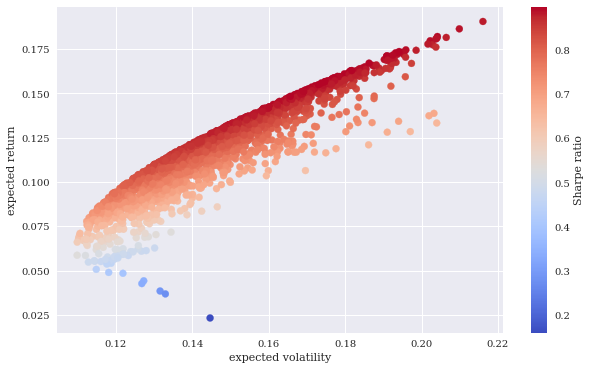

In [258]:
plt.figure(figsize=(10, 6))
plt.scatter(pvols, prets, c=prets / pvols,
            marker='o', cmap='coolwarm')
plt.xlabel('expected volatility')
plt.ylabel('expected return')
plt.colorbar(label='Sharpe ratio');
# plt.savefig('../../images/ch13/stat_12.png')
# 图展示了蒙特卡洛模拟的结果。除此之外，还提供了夏普指数（即预期投资组合超额收益），也就是投资收益率超过无风险短期利率rf的部分除以预期投资组合标准差。简单起见，假定rf=0

作为投资者，人们通常对固定风险水平的最大收益率或者固定收益率预期下的最小风险感兴趣。这两种投资组合组成所谓的有效边界，这是本节后面想要得到的结果

### Portfolio Optimizations

最小化函数很通用，它考虑了参数的（不）等式约束和参数的范围。我们从夏普指数的最大化开始。从形式上说，最小化夏普指数的负值可以得到最大价值和最优投资组合构成。约束是所有参数（权重）的总和为1。用minimize函数的约定表达后面会讲到（参见minimize函数文档）。我们还将参数值（权重）限制在0和1之间，这些值以多个元组组成的一个元组形式提供给最小化函数。

In [259]:
import scipy.optimize as sco

In [260]:
# 需要最小化的函数。最大化问题改成最小化问题
def min_func_sharpe(weights):  
    return -port_ret(weights) / port_vol(weights)  

In [261]:
# 等式约束
cons = ({'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})  

In [262]:
# 参数范围
# 因为不允许放空，所以权重一定在0，1之间
bnds = tuple((0, 1) for x in range(noa))  

In [263]:
# 等权重向量。初始值
eweights = np.array(noa * [1. / noa,])  
eweights  

array([0.25, 0.25, 0.25, 0.25])

In [264]:
min_func_sharpe(eweights)

-0.8436203363155396

In [265]:
%%time
# 优化（即函数min_func_sharpe()的最小化）
opts = sco.minimize(min_func_sharpe, eweights,
                    method='SLSQP', bounds=bnds,
                    constraints=cons)  

Wall time: 39 ms


In [266]:
# 优化结果
# jac: 是每一个变量的切线斜率。最好的情况是所有切线斜率为0
opts  

     fun: -0.8976673894060793
     jac: array([ 8.96826386e-05,  8.30665231e-05, -2.45951116e-04,  1.93193555e-05])
 message: 'Optimization terminated successfully'
    nfev: 30
     nit: 6
    njev: 6
  status: 0
 success: True
       x: array([0.51191353, 0.19126413, 0.25454108, 0.04228127])

In [267]:
# 最优投资组合权重
opts['x'].round(3)  

array([0.512, 0.191, 0.255, 0.042])

In [268]:
# 得出的投资组合回报率
port_ret(opts['x']).round(3)  

0.161

In [269]:
# ❺ 得出的投资组合波动率
port_vol(opts['x']).round(3)  

0.18

In [270]:
# 最大夏普指数
port_ret(opts['x']) / port_vol(opts['x'])  

0.8976673894060793

In [271]:
# 最小化投资组合的方差，这与波动率的最小化相同
optv = sco.minimize(port_vol, eweights,
                    method='SLSQP', bounds=bnds,
                    constraints=cons)  

In [272]:
optv

     fun: 0.1094215526341138
     jac: array([0.11098004, 0.10948556, 0.10939826, 0.10944918])
 message: 'Optimization terminated successfully'
    nfev: 45
     nit: 9
    njev: 9
  status: 0
 success: True
       x: array([1.62630326e-18, 1.06170720e-03, 5.43263079e-01, 4.55675214e-01])

In [273]:
# 投资组合仅由 3 种金融工具构成。这种组合可以得到所谓的绝对最小方差投资组合
optv['x'].round(3)

array([0.   , 0.001, 0.543, 0.456])

In [274]:
port_vol(optv['x']).round(3)

0.109

In [275]:
port_ret(optv['x']).round(3)

0.06

In [276]:
port_ret(optv['x']) / port_vol(optv['x'])

0.5504173653075622

### Efficient Frontier

有效前沿

In [315]:
# 有效边界的两个绑定约束
# 目标收益率水平tret，投资组合权重的总和
# 投资组合的报酬率要等与某一个常数，所以写第一个约束
# 所以这里画出有效前言的方法是通过在不同的报酬率下计算出最小波动度，然后连起来就是有效前沿
cons = ({'type': 'eq', 'fun': lambda x:  port_ret(x) - tret},
        {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})  

In [316]:
bnds = tuple((0, 1) for x in weights)

In [317]:
%%time
trets = np.linspace(0.01, 0.2, 70)
tvols = []
for tret in trets:
    res = sco.minimize(port_vol, eweights, method='SLSQP',
                       bounds=bnds, constraints=cons)  
    tvols.append(res['fun'])
tvols = np.array(tvols)
# 不同目标回报率的组合波动率优化

Wall time: 2.22 s


In [334]:
tvols

array([0.16041754, 0.15577444, 0.15126254, 0.14689395, 0.14268183,
       0.13864043, 0.13478512, 0.13113231, 0.12769938, 0.12450452,
       0.12156649, 0.11890435, 0.11653699, 0.11448272, 0.11275863,
       0.11138006, 0.11035997, 0.10970835, 0.10943178, 0.1094763 ,
       0.10967012, 0.10999941, 0.11046322, 0.11105976, 0.11178691,
       0.11264214, 0.11362255, 0.11472494, 0.11594582, 0.1172815 ,
       0.11872809, 0.12028212, 0.12193815, 0.12369304, 0.12554266,
       0.12748273, 0.1295092 , 0.13161822, 0.13380542, 0.13606745,
       0.13840053, 0.14080114, 0.14326588, 0.1457915 , 0.14837487,
       0.15101304, 0.15370319, 0.15644264, 0.15922884, 0.16205943,
       0.16493239, 0.16784463, 0.17079529, 0.17378112, 0.17680157,
       0.17985436, 0.18293784, 0.18605057, 0.18919123, 0.19235995,
       0.19559108, 0.19889556, 0.20227272, 0.20571015, 0.20921356,
       0.21277683, 0.21639834, 0.2202473 , 0.22443033, 0.22892911])

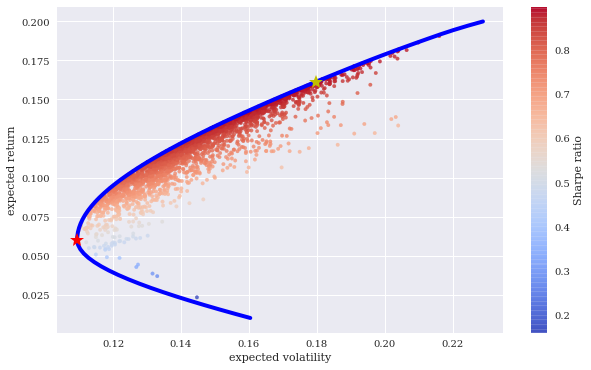

In [318]:
plt.figure(figsize=(10, 6))
plt.scatter(pvols, prets, c=prets / pvols,
            marker='.', alpha=0.8, cmap='coolwarm')
plt.plot(tvols, trets, 'b', lw=4.0)
# opts是最大夏普比率的计算
plt.plot(port_vol(opts['x']), port_ret(opts['x']),
         'y*', markersize=15.0)
# optv是最小波动率组合的计算
plt.plot(port_vol(optv['x']), port_ret(optv['x']),
         'r*', markersize=15.0)
plt.xlabel('expected volatility')
plt.ylabel('expected return')
plt.colorbar(label='Sharpe ratio')
# plt.savefig('../../images/ch13/stat_13.png')

# 该图还出现了两个较大的星号：一个表示最小波动率/方差投资组合（最左侧的组合），另一个表示具有最大夏普指数的投资组合
# 有效边界由所有收益率高于绝对最小方差投资组合的最优投资组合构成。这些投资组合在给定某一风险水平的预期收益率上优于其他所有投资组合。

### Capital Market Line

资本市场线

之前求有效前沿的时候是考虑了所有有风险的资产。资本市场线是当引进无风险资产的时候，考虑组合，使得组合的夏普比率(斜率)最大

为了进行下面的计算，我们需要一个函数逼近和有效边界的一阶导数。3次样条插值提供了这种可导函数逼近（参见第11章）。对于样条插值，我们只使用有效边界中的投资组合。通过这条数值化路径，最终可以为有效边界定义一个连续可导函数f(x)和对应的一阶导数函数df(x)

In [319]:
import scipy.interpolate as sci

In [320]:
# 最小波动率投资组合的指数头寸
ind = np.argmin(tvols) 
# 相关的组合波动率和回报率值 
evols = tvols[ind:]  
# 这些值上的3次样条插值
erets = trets[ind:]  

In [321]:
tck = sci.splrep(evols, erets)  

In [322]:
tck

(array([0.10943178, 0.10943178, 0.10943178, 0.10943178, 0.10967012,
        0.10999941, 0.11046322, 0.11105976, 0.11178691, 0.11264214,
        0.11362255, 0.11472494, 0.11594582, 0.1172815 , 0.11872809,
        0.12028212, 0.12193815, 0.12369304, 0.12554266, 0.12748273,
        0.1295092 , 0.13161822, 0.13380542, 0.13606745, 0.13840053,
        0.14080114, 0.14326588, 0.1457915 , 0.14837487, 0.15101304,
        0.15370319, 0.15644264, 0.15922884, 0.16205943, 0.16493239,
        0.16784463, 0.17079529, 0.17378112, 0.17680157, 0.17985436,
        0.18293784, 0.18605057, 0.18919123, 0.19235995, 0.19559108,
        0.19889556, 0.20227272, 0.20571015, 0.20921356, 0.21277683,
        0.21639834, 0.2202473 , 0.22892911, 0.22892911, 0.22892911,
        0.22892911]),
 array([0.05956522, 0.0656542 , 0.06406423, 0.06894088, 0.07064463,
        0.073698  , 0.07627261, 0.07903762, 0.08175049, 0.08448846,
        0.08722408, 0.08996437, 0.09270706, 0.09544926, 0.09819567,
        0.1009417 , 0.1036

In [323]:
def f(x):
    ''' Efficient frontier function (splines approximation). '''
    return sci.splev(x, tck, der=0)
def df(x):
    ''' First derivative of efficient frontier function. '''
    return sci.splev(x, tck, der=1)

In [324]:
#  描述资本市场线（CML）的方程式
def equations(p, rf=0.01):
    eq1 = rf - p[0]  
    eq2 = rf + p[1] * p[2] - f(p[2])  
    eq3 = p[1] - df(p[2])  
    return eq1, eq2, eq3

In [325]:
# 按照给定初始值解方程
opt = sco.fsolve(equations, [0.01, 0.5, 0.15])  

In [326]:
opt  

array([0.01      , 0.84470991, 0.19525388])

In [327]:
np.round(equations(opt), 6)  

array([ 0., -0.,  0.])

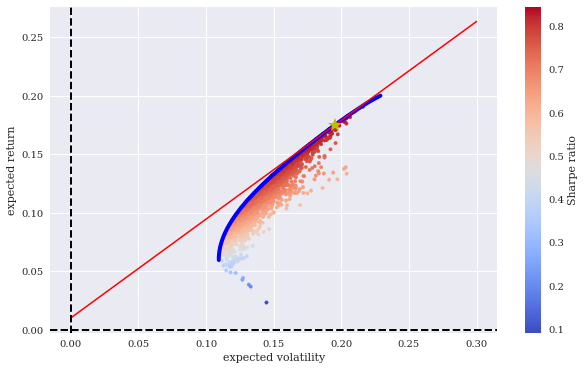

In [328]:
plt.figure(figsize=(10, 6))
plt.scatter(pvols, prets, c=(prets - 0.01) / pvols,
            marker='.', cmap='coolwarm')
plt.plot(evols, erets, 'b', lw=4.0)
cx = np.linspace(0.0, 0.3)
plt.plot(cx, opt[0] + opt[1] * cx, 'r', lw=1.5)
plt.plot(opt[2], f(opt[2]), 'y*', markersize=15.0) 
plt.grid(True)
plt.axhline(0, color='k', ls='--', lw=2.0)
plt.axvline(0, color='k', ls='--', lw=2.0)
plt.xlabel('expected volatility')
plt.ylabel('expected return')
plt.colorbar(label='Sharpe ratio')
# plt.savefig('../../images/ch13/stat_14.png')
# 星号代表有效边界中切线穿过无风险资产点（0，rf = 0.01）的最优化投资组合

In [329]:
cons = ({'type': 'eq', 'fun': lambda x:  port_ret(x) - f(opt[2])},
        {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})  
res = sco.minimize(port_vol, eweights, method='SLSQP',
                   bounds=bnds, constraints=cons)

In [330]:
res['x'].round(3)  

array([0.59 , 0.221, 0.189, 0.   ])

In [331]:
port_ret(res['x'])

0.174932890886287

In [332]:
port_vol(res['x'])

0.19525377642708877

In [333]:
port_ret(res['x']) / port_vol(res['x'])

0.8959257745860298